In [1]:
import main as m
m.i.reload(m)

<module 'main' from 'D:\\ITU-BOOK\\WAM\\whtsrndm\\main.py'>

In [21]:
# file convert from http://download.geonames.org/export/dump/
import csv

lol = list(csv.reader(open('data/dataset/HU.txt', 'rb'), delimiter='\t'))

Error: iterator should return strings, not bytes (the file should be opened in text mode)

In [4]:
#file = m.pd.read_csv("data/dataset/HU.csv", sep='\t', lineterminator='\r')
file = m.pd.read_csv("data/dataset/HU.txt", sep='\t', header=None)

In [14]:
file.rename(columns={1: "name", 4: "lat", 5:"lon", 6:"admin1", 7:"admin2", 8:"cc"}, inplace=True)

In [15]:
# convert 
# 1 - name, 4 - lat, 5-lon, 7-admin1, 8-admin2
#to:
#    lat,lon,name,admin1,admin2,cc

In [31]:
new_file = file[["lat","lon","name","admin1","admin2","cc"]]

In [37]:
new_file

,lat,lon,name,admin1,admin2,cc
0,46.25000,20.20000,Maros,H,STM,HU
1,46.33472,18.89167,Gémesi Révház,P,PPL,HU
2,46.70000,21.26667,Fekete-Körös,H,STM,HU
3,46.93333,20.96667,Fehér-Körös,H,STM,HU
4,48.13333,22.31667,Kraszna-csatorna,H,CNL,HU
...,...,...,...,...,...,...
24541,47.33645,17.45996,Erzsébetváros,P,PPLX,HU
24542,46.88375,19.40318,Kiskunság national park,L,RESN,HU
24543,47.40253,19.09182,Csepel-Királyerdő,P,PPLX,HU
24544,46.05463,18.20594,Füzes dűlő,P,PPLX,HU


In [110]:
new_file.to_csv('data/dataset/HU-proc.csv',sep=",", index=False, encoding='utf-8-sig')
#new_file.to_csv('data/dataset/HU-proc.csv',sep=",", index=False, encoding='utf-8')

In [2]:
geo = m.rg.RGeocoder(mode=1, verbose=True, stream=m.io.StringIO(open('data/dataset/HU-proc.csv', encoding='utf-8-sig').read())) 

In [6]:
# read in 
PATH = {}
PATH["rawDATA"] = "data/unprocessed/"
locations = {}
place = "Hungary"
keys = ["attraction", "artwork", "gallery", "museum", "viewpoint", "yes", "memorial", "monument"]
for k in keys:
    print(k)
    try:
        locations[k] = m.gpd.read_parquet(PATH["rawDATA"]+place+"-"+k+".parquet")
    except:
        locations[k] = m.pd.read_csv(PATH["rawDATA"]+place+"-"+k+".csv", low_memory=False)
        locations[k]["geometry"] = locations[k]["geometry"].apply(m.wkt.loads)
        locations[k] = m.gpd.GeoDataFrame(locations[k], geometry = locations[k]["geometry"], crs = 'EPSG:4326')
        #t = m.gpd.GeoDataFrame(locations[k], geometry = m.gpd.points_from_xy(locations[k]['x'], locations[k]['y']), crs = 'EPSG:4326')
        #locations[k].crs = "epsg:4326"
        #t = m.pd.read_csv(PATH["rawDATA"]+k+".csv")
        #locations[k] = m.gpd.GeoDataFrame(t, geometry=t.geometry, crs = 'EPSG:4326')

attraction
artwork
gallery
museum
viewpoint
yes
memorial
monument


## TODO


In [7]:
# find the nearest city
def regCharEnc(inp):
    return inp
    # return inp.replace("Ĺ\x90", "Ő").replace('Ă\x96', 'Ö').replace('ĂĄ', 'á').replace('ĂŠ', 'é').replace("Ĺą", "ű").replace("Ĺ\x91", "ő").replace("Ă\x9a", "Ú").replace("Ăł", "ó").replace("Ăş", "ú").replace("Ă\x81", "Á").replace("Ă\x93", "Ó").replace("Ăź", "ü").replace("Ă\x89", "É").replace("Ăś","ö").replace("Ă\xad", "í")

for k in keys:
    coords = []
    for _, r in locations[k].iterrows():
        # search for the closest city/village
        coords.append((r.geometry.centroid.y,r.geometry.centroid.x))
    results = geo.query(coords)
    #print(results)
    #results = m.rg.search(coords)
    # closest city write
    #l = list(map(lambda x: regCharEnc(x["name"]), results))

    locations[k]["closestCity"] = list(map(lambda x: regCharEnc(x["name"]), results))
    #locations[k]["closestCity"] = ""

In [8]:
for k in keys:
    display(locations[k][["geometry","closestCity", "name"]].explore("closestCity"))

In [9]:
# save the dataframe again

# oh, it saved everything in parquet. Hm.
for k in keys:
    try:
        locations[k].to_parquet(PATH["rawDATA"]+place+"-"+k+".parquet")
    except:
        locations[k].to_csv(PATH["rawDATA"]+place+"-"+k+".csv")

In [ ]:
# has to run in custom mode
# https://github.com/thampiman/reverse-geocoder

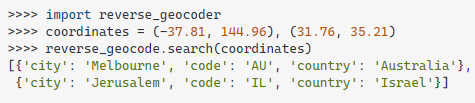

In [ ]:
# hm, check this
# http://download.geonames.org/export/dump/

In [ ]:
# http://download.geonames.org/export/dump/

In [78]:
keys = ["attraction", "artwork", "gallery", "museum", "viewpoint", "yes"] #artwork,viewpoint, yes are wrong
locations[keys[0]].explore("closestCity")

In [81]:
set(locations[keys[2]].closestCity)

{'Balassagyarmat',
 'Balatonalmadi',
 'Balatonboglar',
 'Balatonfured',
 'Baracska',
 'Budakalasz',
 'Budakeszi',
 'Budapest',
 'Budapest I. keruelet',
 'Budapest II. keruelet',
 'Budapest III. keruelet',
 'Budapest IV. keruelet',
 'Budapest IX. keruelet',
 'Budapest VI. keruelet',
 'Budapest VII. keruelet',
 'Budapest VIII. keruelet',
 'Budapest X. keruelet',
 'Budapest XI. keruelet',
 'Budapest XII. keruelet',
 'Budapest XIV. keruelet',
 'Budapest XIX. keruelet',
 'Budapest XV. keruelet',
 'Budapest XVI. keruelet',
 'Budapest XVII. keruelet',
 'Budapest XVIII. keruelet',
 'Budapest XX. keruelet',
 'Budapest XXI. keruelet',
 'Budapest XXII. keruelet',
 'Budapest XXIII. keruelet',
 'Csopak',
 'Debrecen',
 'Eger',
 'Fehergyarmat',
 'Godollo',
 'Gyal',
 'Gyonk',
 'Gyor',
 'Gyula',
 'Hajdunanas',
 'Halasztelek',
 'Hatvan',
 'Kaposmero',
 'Kobilje',
 'Kormend',
 'Kunmadaras',
 'Mezokovesd',
 'Miskolc',
 'Nagykanizsa',
 'Nagymaros',
 'Pannonhalma',
 'Paszto',
 'Pecs',
 'Pilisvorosvar',
 'Pu